In [1]:
import pandas as pd
pd.set_option("display.max_columns", None)
pd.set_option("display.max_rows", 400)
import Random_event_simulation as rand_event
import Visu_data as visu
import numpy as np
import plotly.graph_objects as go
import matplotlib.pyplot as plt
from arch import arch_model
import statsmodels.api as sm

In [2]:
file = '/Users/edouard/Desktop/Rosenbaum/Price-Impact-and-other-HF-stuffs/Rosenbaum/xnas-itch-20240726.mbp-10.csv'
df   = pd.read_csv(file)
df.head()

data = visu.data_analysis(df)
data.stats_()


 -- Dataset statistics -- 

Tick                                  : 0.01
Average Bid-ask                       : 0.01746234205275989
Number of Jumps of more than just one : 15061
Number of Jumps of less than just one : 58387
Average jump size (up)                : 1.34635940989048
Average jump size (down)              : -1.2569750115600498
Number of up jumps                    : 54634
Number of down jumps                  : 58387

 -- Graphs -- 


In [3]:
data.df['mid_price_diff'] = data.df['mid'].diff(1)/data.tick
print(data.df[data.df['mid_price_diff']>100].head())

Empty DataFrame
Columns: [ts_event, action, side, size, price, bid_px_00, ask_px_00, bid_sz_00, ask_sz_00, bid_ct_00, ask_ct_00, bid_px_01, ask_px_01, bid_sz_01, ask_sz_01, bid_ct_01, ask_ct_01, time_diff, price_same, price_opposite, size_same, size_opposite, nb_ppl_same, nb_ppl_opposite, diff_price, Mean_price_diff, imbalance, indice, bid_sz_00_diff, ask_sz_00_diff, status, new_limite, price_middle, mid, time_sec, mid_price_diff]
Index: []


In [4]:
print(data.jump_counts_up)

{3: 3162, 5: 22, 7: 5, 8: 3, 1: 39573, 2: 11606, 4: 252, 6: 6, 20: 1, 11: 1, 17: 1, 15: 1, 10: 1}


In [5]:
data.df.head()

,ts_event,action,side,size,price,bid_px_00,ask_px_00,bid_sz_00,ask_sz_00,bid_ct_00,ask_ct_00,bid_px_01,ask_px_01,bid_sz_01,ask_sz_01,bid_ct_01,ask_ct_01,time_diff,price_same,price_opposite,size_same,size_opposite,nb_ppl_same,nb_ppl_opposite,diff_price,Mean_price_diff,imbalance,indice,bid_sz_00_diff,ask_sz_00_diff,status,new_limite,price_middle,mid,time_sec,mid_price_diff
0,2024-07-26 14:00:00.006110435+00:00,A,A,30,164.96,164.93,164.96,20,150,1,3,164.92,164.97,71,768,3,4,0.000224,164.96,164.93,150,20,3,1,0.000,NaN,0.764706,1,0,30,OK,n,0.015,164.945,0.000000,NaN
2,2024-07-26 14:00:00.010217234+00:00,C,B,50,164.92,164.92,164.96,21,120,2,2,164.91,164.97,135,768,6,4,0.000052,164.92,164.96,21,120,2,2,0.000,NaN,0.702128,4,-50,0,OK,n,0.020,164.940,0.004107,-0.5
5,2024-07-26 14:00:00.010540788+00:00,A,A,20,164.95,164.90,164.95,196,70,7,2,164.89,164.96,101,240,5,4,0.000019,164.95,164.90,70,196,2,7,0.000,NaN,-0.473684,10,0,20,OK,n,0.025,164.925,0.004430,-1.5
7,2024-07-26 14:00:00.010790819+00:00,C,B,7,164.89,164.89,164.95,94,70,4,2,164.88,164.96,192,240,7,4,0.000062,164.89,164.95,94,70,4,2,0.005,NaN,-0.146341,12,92,0,NOK,n,0.030,164.920,0.004680,-0.5
8,2024-07-26 14:00:00.010852244+00:00,A,A,3,164.94,164.89,164.94,94,3,4,1,164.88,164.95,192,70,7,2,0.000061,164.94,164.89,3,94,1,4,-0.005,NaN,-0.938144,13,0,-67,NOK,n,0.025,164.915,0.004742,-0.5


In [6]:
df_ = data.df

In [7]:
dic_up = data.jump_size_up
dic_down = data.jump_size_down

In [8]:
print(data.jump_size_up)

{3: [20, 200, 11, 2, 20, 20, 3, 38, 20, 20, 20, 50, 66, 100, 84, 22, 20, 20, 20, 7, 40, 9, 50, 22, 50, 200, 20, 1, 38, 50, 100, 50, 50, 38, 50, 50, 100, 30, 10, 100, 7, 50, 1, 100, 50, 30, 20, 20, 17, 100, 20, 306, 100, 20, 21, 9, 20, 1, 20, 100, 50, 6, 50, 20, 20, 14, 20, 20, 20, 20, 100, 20, 20, 50, 20, 22, 20, 400, 20, 10, 100, 22, 22, 100, 22, 10, 100, 22, 50, 10, 50, 66, 100, 22, 4, 50, 20, 20, 20, 20, 100, 20, 10, 66, 66, 50, 100, 22, 100, 66, 100, 13, 100, 50, 37, 2, 20, 600, 20, 50, 50, 5, 10, 20, 10, 100, 10, 100, 10, 100, 20, 400, 400, 50, 200, 50, 200, 10, 10, 100, 100, 22, 22, 7, 107, 66, 50, 20, 200, 50, 100, 22, 22, 22, 600, 600, 30, 100, 100, 100, 39, 9, 22, 50, 7, 100, 20, 20, 30, 20, 19, 20, 126, 50, 20, 10, 10, 10, 10, 20, 50, 50, 4, 50, 36, 50, 7, 100, 100, 13, 100, 100, 1, 6, 20, 100, 30, 50, 66, 100, 200, 100, 100, 100, 200, 20, 135, 20, 5, 8, 50, 50, 20, 100, 100, 100, 20, 20, 1, 7, 50, 100, 90, 600, 20, 20, 100, 100, 50, 234, 22, 10, 100, 40, 100, 100, 10, 20, 10

In [9]:
size_down = []
jumps_down = []
for i in dic_down.keys():
    jumps_down.append(i)
    size_down.append(np.mean(np.array(dic_down[i])))

jumps_down = np.array(jumps_down)
size_down = np.array(size_down)
ind_down = np.argsort(jumps_down)
jumps_down = jumps_down[ind_down]
size_down = size_down[ind_down]
size_up = []
jumps_up = []
for i in dic_up.keys():
    jumps_up.append(i)
    size_up.append(np.mean(np.array(dic_up[i])))

jumps_up = np.array(jumps_up)
size_up = np.array(size_up)
ind_up = np.argsort(jumps_up)
jumps_up = jumps_up[ind_up]
size_up = size_up[ind_up]

In [10]:
fig = go.Figure()
fig.add_trace(go.Scatter(x=jumps_up, y=size_up, mode='lines', name="up", line=dict(width = 0.85, color = 'darkblue')))
fig.add_trace(go.Scatter(x=jumps_down, y=size_down, mode='lines', name="down", line=dict(width = 0.85, color = 'darkblue')))
fig.update_layout(
    title="Number of events N+ and N-",
    xaxis_title="Jump",
    yaxis_title="Size",
    plot_bgcolor='#D3D3D3',
    paper_bgcolor='#D3D3D3',
    xaxis=dict(showgrid=True, gridcolor='#808080'),
    yaxis=dict(showgrid=True, gridcolor='#808080')
)
fig.show()

In [11]:
dframe = data.df_
dframe["time_float"] = pd.to_datetime(dframe["ts_event"]).astype("int64")
dframe["time_float"] = dframe["time_float"] - dframe["time_float"].iloc[0]
dframe["delta_time"] = dframe["time_float"].diff(1)
dframe["delta_time"] = dframe["delta_time"].bfill()
dframe["time_float"] = dframe["time_float"]/dframe["time_float"].iloc[-1]
series = dframe["delta_time"].to_numpy()/1e4
# series = dframe['size']
dframe["mid"] = (dframe["bid_px_00"]+dframe["ask_px_00"])/2
# dframe = dframe[dframe["mid"].diff(1) != 0]
dframe = dframe[dframe["action"] == "T"]
dframe["rdt"] = np.abs(np.log(dframe["mid"])-np.log(dframe["mid"].shift(1)))
print(dframe["rdt"])
# dframe = dframe.dropna()

# print(len(dframe))
# dframe = dframe.dropna()
# series = dframe["size"].to_numpy()

# dframe["time_float"] = pd.to_datetime(dframe["ts_event"]).astype("int64")
# dframe["time_float"] = dframe["time_float"] - dframe["time_float"].iloc[0]
# dframe["delta_time"] = dframe["time_float"].diff(1)
# dframe["delta_time"] = dframe["delta_time"].bfill()
# series = dframe["delta_time"].to_numpy()/1e4
dframe["volat"] = dframe["rdt"].rolling(window = 200).std()
print(len(dframe))
dframe = dframe.dropna()
series = dframe["volat"].to_numpy()



10             NaN
13        0.000061
14        0.000030
15        0.000030
22        0.000212
            ...   
802694    0.000060
802974    0.000060
803007    0.000000
803058    0.000180
803108    0.000000
Name: rdt, Length: 25281, dtype: float64
25281


In [12]:
print(series)

[7.18419125e-05 7.19109115e-05 7.19704902e-05 ... 7.31884062e-05
 7.36825939e-05 7.37653455e-05]


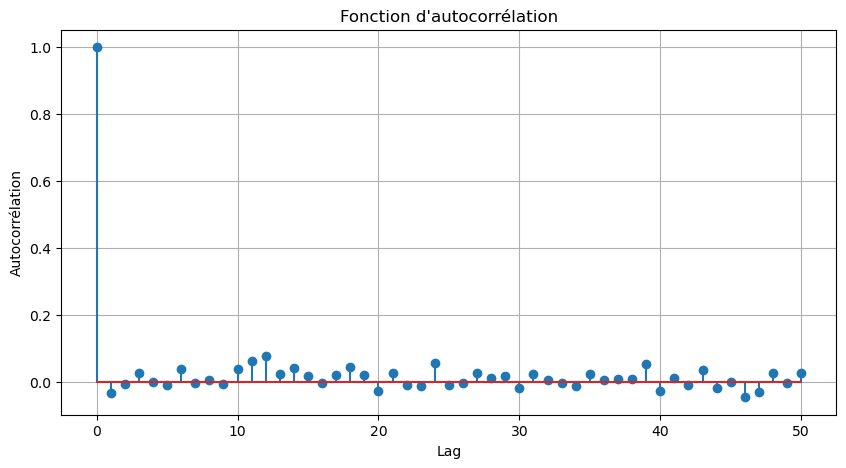

In [13]:
def plot_autocorrelation(series, max_lag=50):
    acf = [series.autocorr(lag=i) for i in range(max_lag + 1)]
    plt.figure(figsize=(10, 5))
    plt.stem(range(max_lag + 1), acf)
    plt.xlabel("Lag")
    plt.ylabel("Autocorrélation")
    plt.title("Fonction d'autocorrélation")
    plt.grid(True)
    plt.show()

data = np.random.randn(1000)
series = pd.Series(data)

plot_autocorrelation(series, max_lag=50)


In [14]:
fig = go.Figure()
fig.add_trace(go.Scatter(x = dframe['time_float'], y = dframe["volat"]))
fig.show()

In [15]:
t_min = dframe["time_float"].min()
t_max = dframe["time_float"].max()
nb_points = 1000
uniform_times = np.linspace(t_min, t_max, nb_points)
df_uniform = pd.DataFrame({'time_float': uniform_times})
dframe_sorted = dframe.sort_values("time_float")
df_uniform = pd.merge_asof(df_uniform, dframe_sorted, on="time_float", direction="nearest")



In [30]:
fig = go.Figure()
fig.add_trace(go.Scatter(x = df_uniform['time_float'], y = df_uniform["volat"]))
fig.update_layout(
    width = 1800,
    height = 1400,
    xaxis_title='Time (Normalisé)',
    yaxis_title='Volatilité',
    template='plotly_white'
)

fig.show()


In [17]:
time = df_uniform["time_float"]
volatility = df_uniform["volat"]

In [18]:


df = df_uniform.sort_values("time_float").reset_index(drop=True)

n = len(df)
train_size = int(0.8 * n)
train_data = df["volat"].iloc[:train_size].copy()
test_data = df["volat"].iloc[train_size:].copy()
time_test = df["time_float"].iloc[train_size:].copy()

predictions = []
predicted_times = []

current_train = train_data.copy()

p_values = [1, 2, 3,4,5,6]
q_values = [1, 2, 3,4,5,6]

def grid_search_garch(series, p_vals, q_vals, mean='Zero', vol='Garch', dist='Normal'):
    best_aic = np.inf
    best_model = None
    best_p = None
    best_q = None
    for p in p_vals:
        for q in q_vals:
            try:
                model = arch_model(series, mean=mean, vol=vol, p=p, q=q, dist=dist)
                res = model.fit(disp="off", show_warning=False)
                if res.aic < best_aic:
                    best_aic = res.aic
                    best_model = res
                    best_p = p
                    best_q = q
            except Exception as e:
                continue
    return best_model, best_p, best_q, best_aic

for i in range(len(test_data)):
    best_model, best_p, best_q, best_aic = grid_search_garch(current_train, p_values, q_values, mean='Zero', vol='Garch', dist='Normal')
    
    forecast = best_model.forecast(horizon=1)
    pred_vol = np.sqrt(forecast.variance.iloc[-1].values[0])
    predictions.append(pred_vol)
    predicted_times.append(time_test.iloc[i])
    
    current_train = pd.concat([current_train, pd.Series([test_data.iloc[i]])], ignore_index=True)

print(best_model, best_p, best_q, best_aic)
fig = go.Figure()

fig.add_trace(go.Scatter(
    x=predicted_times,
    y=test_data.values,
    mode='lines+markers',
    name='Volatilité Réelle'
))

fig.add_trace(go.Scatter(
    x=predicted_times,
    y=predictions,
    mode='lines+markers',
    name='Volatilité Prédite (Rolling Forecast)'
))

fig.update_layout(
    title='Rolling One-step Ahead Forecast avec optimisation de p et q',
    xaxis_title='Time (en secondes)',
    yaxis_title='Volatilité',
    template='plotly_white'
)

fig.show()


                       Zero Mean - GARCH Model Results                        
Dep. Variable:                   None   R-squared:                       0.000
Mean Model:                 Zero Mean   Adj. R-squared:                  0.001
Vol Model:                      GARCH   Log-Likelihood:                8123.25
Distribution:                  Normal   AIC:                          -16240.5
Method:            Maximum Likelihood   BIC:                          -16225.8
                                        No. Observations:                  999
Date:                Sun, Mar 30 2025   Df Residuals:                      999
Time:                        21:52:53   Df Model:                            0
                               Volatility Model                              
                 coef    std err          t      P>|t|       95.0% Conf. Int.
-----------------------------------------------------------------------------
omega      1.0591e-10  2.004e-09  5.286e-02      0.958 

In [19]:
df = df_uniform.sort_values("time_float").reset_index(drop=True)

n = len(df)
train_size = int(0.8 * n)
train_data = df["volat"].iloc[:train_size].copy()
test_data = df["volat"].iloc[train_size:].copy()
time_test = df["time_float"].iloc[train_size:].copy()

def grid_search_garch(series, p_vals, q_vals, mean='Zero', vol='Garch', dist='Normal'):
    best_aic = np.inf
    best_model = None
    best_p = None
    best_q = None
    for p in p_vals:
        for q in q_vals:
            try:
                model = arch_model(series, mean=mean, vol=vol, p=p, q=q, dist=dist)
                res = model.fit(disp="off", show_warning=False)
                if res.aic < best_aic:
                    best_aic = res.aic
                    best_model = res
                    best_p = p
                    best_q = q
            except Exception as e:
                continue
    return best_model, best_p, best_q, best_aic

p_values = [1, 2, 3]
q_values = [1, 2, 3]

models_to_try = {
    "GARCH": "Garch",
    #"EGARCH": "EGarch",
    "APARCH": "APARCH",
    "FIGARCH": "FIGARCH"
}

predictions_dict = {}
times_dict = {}

for model_name, vol_param in models_to_try.items():
    current_train = train_data.copy()
    preds = []
    pred_times = []
    print(model_name)
    for i in range(len(test_data)):
        best_model, best_p, best_q, best_aic = grid_search_garch(current_train, p_values, q_values, mean='Zero', vol=vol_param, dist='Normal')
        if best_model is None:
            model_default = arch_model(current_train, mean='Zero', vol=vol_param, p=1, q=1, dist='Normal')
            best_model = model_default.fit(disp="off", show_warning=False)
        forecast = best_model.forecast(horizon=1)
        pred_vol = np.sqrt(forecast.variance.iloc[-1].values[0])
        preds.append(pred_vol)
        pred_times.append(time_test.iloc[i])
        current_train = pd.concat([current_train, pd.Series([test_data.iloc[i]])], ignore_index=True)
    predictions_dict[model_name] = preds
    times_dict[model_name] = pred_times

def har_forecast(series):
    if len(series) < 22:
        return series.iloc[-1]
    df_reg = pd.DataFrame({
        'volat': series,
        'lag1': series.shift(1),
        'lag5': series.rolling(window=5).mean().shift(1),
        'lag22': series.rolling(window=22).mean().shift(1)
    }).dropna()
    if df_reg.empty:
        return series.iloc[-1]
    X = df_reg[['lag1', 'lag5', 'lag22']]
    X = sm.add_constant(X)
    y = df_reg['volat']
    reg_model = sm.OLS(y, X).fit()
    last_val = series.iloc[-1]
    last_week = series.iloc[-5:].mean()
    last_month = series.iloc[-22:].mean() if len(series) >= 22 else series.mean()
    X_next = [1, last_val, last_week, last_month]
    return reg_model.predict(X_next)[0]

current_train_har = train_data.copy()
har_predictions = []
har_times = []
for i in range(len(test_data)):
    pred = har_forecast(current_train_har)
    har_predictions.append(pred)
    har_times.append(time_test.iloc[i])
    current_train_har = pd.concat([current_train_har, pd.Series([test_data.iloc[i]])], ignore_index=True)

predictions_dict["HAR"] = har_predictions
times_dict["HAR"] = har_times
from statsmodels.tsa.arima.model import ARIMA

current_train_arima = train_data.copy()
arima_predictions = []
arima_times = []
for i in range(len(test_data)):
    try:
        model_arima = ARIMA(current_train_arima, order=(1, 0, 0))
        res_arima = model_arima.fit()
        forecast_arima = res_arima.forecast(steps=1)
        pred_arima = forecast_arima.iloc[0]
    except Exception as e:
        pred_arima = current_train_arima.iloc[-1]
    arima_predictions.append(pred_arima)
    arima_times.append(time_test.iloc[i])
    current_train_arima = pd.concat([current_train_arima, pd.Series([test_data.iloc[i]])], ignore_index=True)

predictions_dict["ARIMA"] = arima_predictions
times_dict["ARIMA"] = arima_times

from statsmodels.tsa.statespace.sarimax import SARIMAX

seasonal_order = (1, 0, 0, 10)
current_train_sarima = train_data.copy()
sarima_predictions = []
sarima_times = []
for i in range(len(test_data)):
    try:
        model_sarima = SARIMAX(current_train_sarima, order=(1, 0, 0), seasonal_order=seasonal_order,
                                enforce_stationarity=False, enforce_invertibility=False)
        res_sarima = model_sarima.fit(disp=False)
        forecast_sarima = res_sarima.forecast(steps=1)
        pred_sarima = forecast_sarima.iloc[0]
    except Exception as e:
        pred_sarima = current_train_sarima.iloc[-1]
    sarima_predictions.append(pred_sarima)
    sarima_times.append(time_test.iloc[i])
    current_train_sarima = pd.concat([current_train_sarima, pd.Series([test_data.iloc[i]])], ignore_index=True)

predictions_dict["SARIMA"] = sarima_predictions
times_dict["SARIMA"] = sarima_times

fig = go.Figure()

fig.add_trace(go.Scatter(
    x=time_test,
    y=test_data.values,
    mode='lines+markers',
    name='Volatilité Réelle'
))

for model_name, preds in predictions_dict.items():
    fig.add_trace(go.Scatter(
        x=times_dict[model_name],
        y=preds,
        mode='lines+markers',
        name=f"{model_name} Prédiction"
    ))

fig.update_layout(
    title="Rolling One-step Ahead Forecast avec optimisation de (p, q) et modèle HAR",
    xaxis_title="Time (en secondes)",
    yaxis_title="Volatilité",
    template="plotly_white"
)

fig.show()

GARCH
APARCH
FIGARCH


/Users/edouard/miniforge3/envs/IA_m1/lib/python3.9/site-packages/statsmodels/base/model.py:607: ConvergenceWarning:

Maximum Likelihood optimization failed to converge. Check mle_retvals

/Users/edouard/miniforge3/envs/IA_m1/lib/python3.9/site-packages/statsmodels/base/model.py:607: ConvergenceWarning:

Maximum Likelihood optimization failed to converge. Check mle_retvals

/Users/edouard/miniforge3/envs/IA_m1/lib/python3.9/site-packages/statsmodels/base/model.py:607: ConvergenceWarning:

Maximum Likelihood optimization failed to converge. Check mle_retvals

/Users/edouard/miniforge3/envs/IA_m1/lib/python3.9/site-packages/statsmodels/base/model.py:607: ConvergenceWarning:

Maximum Likelihood optimization failed to converge. Check mle_retvals

/Users/edouard/miniforge3/envs/IA_m1/lib/python3.9/site-packages/statsmodels/base/model.py:607: ConvergenceWarning:

Maximum Likelihood optimization failed to converge. Check mle_retvals

/Users/edouard/miniforge3/envs/IA_m1/lib/python3.9/site-pack

In [20]:
import numpy as np
import plotly.graph_objects as go

fig_diff = go.Figure()
real_diff = np.diff(test_data.values)/test_data.values[1:]
times_real = np.array(time_test)[1:]
fig_diff.add_trace(go.Scatter(
    x=times_real,
    y=real_diff,
    mode='lines+markers',
    name="Différence Réelle (vol[i]-vol[i-1])",
    line=dict(color="black", dash="dash")
))
for model_name, preds in predictions_dict.items():
    preds_array = np.array(preds)
    diff_preds = np.diff(preds_array)/preds_array[1:]
    times_model = np.array(times_dict[model_name])[1:]
    
    fig_diff.add_trace(go.Scatter(
        x=times_model,
        y=diff_preds,
        mode='lines+markers',
        name=f"{model_name} Diff (vol[i]-vol[i-1])"
    ))

fig_diff.update_layout(
    title="Evolution de la différence de volatilité prédite (vol[i]-vol[i-1])",
    xaxis_title="Time (en secondes)",
    yaxis_title="Différence de Volatilité",
    template="plotly_white"
)

fig_diff.show()


In [21]:
import numpy as np
import pandas as pd
import plotly.graph_objects as go

real_diff = np.diff(test_data.values) / test_data.values[:-1]
times_real = np.array(time_test)[1:]

fig_error = go.Figure()
fig_error.add_trace(go.Scatter(
        x=times_real,
        y=np.abs(real_diff),
        mode='lines+markers',
        name=f"Precedent Value"
    ))
error_metrics = {}
error_metrics["Precedent Value"] = {
        "Variance": np.var(real_diff ),
        "Moyenne": np.mean(real_diff ),
        "Moyenne ABS": np.mean(np.abs(real_diff ))
    }

for model_name, preds in predictions_dict.items():
    preds_array = np.array(preds)
    diff_preds = np.diff(preds_array) / preds_array[:-1]
    error = real_diff - diff_preds
    times_model = np.array(times_dict[model_name])[1:]
    
    fig_error.add_trace(go.Scatter(
        x=times_model,
        y=np.abs(error),
        mode='lines+markers',
        name=f"{model_name} Erreur (Réel - Prédit)"
    ))
    
    error_metrics[model_name] = {
        "Variance": np.var(error),
        "Moyenne": np.mean(error),
        "Moyenne ABS": np.mean(np.abs(error))
    }


fig_error.update_layout(
    title="Évolution de l'erreur (Réel - Prédit) de la différence de volatilité",
    xaxis_title="Time (en secondes)",
    yaxis_title="Erreur (Réel - Prédit)",
    template="plotly_white"
)

fig_error.show()

metrics_df = pd.DataFrame(error_metrics).T
print(metrics_df)


                 Variance   Moyenne  Moyenne ABS
Precedent Value  0.002609  0.002576     0.034577
GARCH            0.003419  0.002071     0.041449
APARCH           0.005050  0.000451     0.049965
FIGARCH          0.004252  0.001038     0.045824
HAR              0.005344  0.000264     0.051498
ARIMA            0.005080  0.000431     0.050157
SARIMA           0.010358 -0.002155     0.078682


In [22]:
import numpy as np
import pandas as pd
import plotly.graph_objects as go
from arch import arch_model
import statsmodels.api as sm

import tensorflow as tf
from tensorflow.keras.models import Sequential, Model
from tensorflow.keras.layers import (Input, LSTM, GRU, Dense, Conv1D, Flatten,
                                     BatchNormalization, Add, Activation, Dropout,
                                     MultiHeadAttention, LayerNormalization)
from tensorflow.keras.optimizers import Adam

from sklearn.ensemble import RandomForestRegressor, GradientBoostingRegressor

# ------------------------------------------------------------
# 0. Préparation des données
# ------------------------------------------------------------
# On part du DataFrame uniformisé et trié par time_float (df_uniform).
# Vous devez avoir df_uniform défini avant ce code.
df = df_uniform.sort_values("time_float").reset_index(drop=True)

n = len(df)
train_size = int(0.8 * n)
train_data = df["volat"].iloc[:train_size].copy()
test_data = df["volat"].iloc[train_size:].copy()
time_test = df["time_float"].iloc[train_size:].copy()

# ------------------------------------------------------------
# 1. Modèles classiques (ARCH/GARCH et HAR)
# ------------------------------------------------------------

def grid_search_garch(series, p_vals, q_vals, mean='Zero', vol='Garch', dist='Normal'):
    """
    Recherche en grille pour trouver la meilleure combinaison (p,q) 
    minimisant l'AIC pour un modèle arch_model.
    """
    best_aic = np.inf
    best_model = None
    best_p = None
    best_q = None
    for p in p_vals:
        for q in q_vals:
            try:
                model = arch_model(series, mean=mean, vol=vol, p=p, q=q, dist=dist)
                res = model.fit(disp="off", show_warning=False)
                if res.aic < best_aic:
                    best_aic = res.aic
                    best_model = res
                    best_p = p
                    best_q = q
            except Exception:
                continue
    return best_model, best_p, best_q, best_aic

p_values = [1, 2, 3]
q_values = [1, 2, 3]

models_to_try = {
    "GARCH": "Garch",
    #"EGARCH": "EGarch",
    "APARCH": "APARCH",
    "FIGARCH": "FIGARCH"
}

predictions_dict = {}
times_dict = {}

# Rolling forecast pour chaque modèle ARCH/GARCH
for model_name, vol_param in models_to_try.items():
    current_train = train_data.copy()
    preds = []
    pred_times = []
    print(f"Rolling forecast pour {model_name}...")
    for i in range(len(test_data)):
        best_model, best_p, best_q, best_aic = grid_search_garch(
            current_train, p_values, q_values, mean='Zero', vol=vol_param, dist='Normal'
        )
        if best_model is None:
            model_default = arch_model(current_train, mean='Zero', vol=vol_param, p=1, q=1, dist='Normal')
            best_model = model_default.fit(disp="off", show_warning=False)
        forecast = best_model.forecast(horizon=1)
        pred_vol = np.sqrt(forecast.variance.iloc[-1].values[0])
        preds.append(pred_vol)
        pred_times.append(time_test.iloc[i])
        # Mise à jour
        current_train = pd.concat([current_train, pd.Series([test_data.iloc[i]])], ignore_index=True)
    predictions_dict[model_name] = preds
    times_dict[model_name] = pred_times

# Modèle HAR
def har_forecast(series):
    if len(series) < 22:
        return series.iloc[-1]
    df_reg = pd.DataFrame({
         'volat': series,
         'lag1': series.shift(1),
         'lag5': series.rolling(window=5).mean().shift(1),
         'lag22': series.rolling(window=22).mean().shift(1)
    }).dropna()
    if df_reg.empty:
        return series.iloc[-1]
    X = df_reg[['lag1', 'lag5', 'lag22']]
    X = sm.add_constant(X)
    y = df_reg['volat']
    reg_model = sm.OLS(y, X).fit()
    last_val = series.iloc[-1]
    last_week = series.iloc[-5:].mean()
    last_month = series.iloc[-22:].mean() if len(series) >= 22 else series.mean()
    X_next = [1, last_val, last_week, last_month]
    return reg_model.predict(X_next)[0]

current_train_har = train_data.copy()
har_predictions = []
har_times = []
for i in range(len(test_data)):
    pred = har_forecast(current_train_har)
    har_predictions.append(pred)
    har_times.append(time_test.iloc[i])
    current_train_har = pd.concat([current_train_har, pd.Series([test_data.iloc[i]])], ignore_index=True)

predictions_dict["HAR"] = har_predictions
times_dict["HAR"] = har_times

# ------------------------------------------------------------
# 2. Modèles Deep Learning et ML (utilisant une fenêtre look_back)
# ------------------------------------------------------------
look_back = 20

def create_sequences(data, look_back):
    """
    Crée X, y pour un usage par LSTM/GRU/CNN/Transformers/etc.
    """
    X, y = [], []
    for i in range(len(data) - look_back):
        X.append(data[i:i+look_back])
        y.append(data[i+look_back])
    return np.array(X), np.array(y)

train_values = train_data.values
X_train, y_train = create_sequences(train_values, look_back)
# Reshape en (samples, timesteps, features)
X_train = X_train.reshape((X_train.shape[0], X_train.shape[1], 1))

# # -------------------------------------
# # 2.1 LSTM (modifié : epochs réduits, activation tanh)
# def build_lstm_model(look_back):
#     model = Sequential()
#     model.add(LSTM(50, activation='tanh', input_shape=(look_back, 1)))
#     model.add(Dense(1))
#     model.compile(optimizer='adam', loss='mse')
#     return model

# lstm_model = build_lstm_model(look_back)
# lstm_model.fit(X_train, y_train, epochs=10, batch_size=32, verbose=1)

# lstm_predictions = []
# lstm_times = []
# current_input = list(train_values[-look_back:])
# for i in range(len(test_data)):
#     current_input_arr = np.array(current_input).reshape((1, look_back, 1))
#     pred = lstm_model.predict(current_input_arr, verbose=0)[0,0]
#     lstm_predictions.append(pred)
#     lstm_times.append(time_test.iloc[i])
#     # Mise à jour de la fenêtre
#     current_input.append(test_data.values[i])
#     current_input.pop(0)
# predictions_dict["LSTM"] = lstm_predictions
# times_dict["LSTM"] = lstm_times

# # -------------------------------------
# # 2.2 GRU (modifié : epochs réduits, activation tanh)
# def build_gru_model(look_back):
#     model = Sequential()
#     model.add(GRU(50, activation='tanh', input_shape=(look_back, 1)))
#     model.add(Dense(1))
#     model.compile(optimizer='adam', loss='mse')
#     return model

# gru_model = build_gru_model(look_back)
# gru_model.fit(X_train, y_train, epochs=10, batch_size=32, verbose=1)

# gru_predictions = []
# gru_times = []
# current_input = list(train_values[-look_back:])
# for i in range(len(test_data)):
#     current_input_arr = np.array(current_input).reshape((1, look_back, 1))
#     pred = gru_model.predict(current_input_arr, verbose=0)[0,0]
#     gru_predictions.append(pred)
#     gru_times.append(time_test.iloc[i])
#     current_input.append(test_data.values[i])
#     current_input.pop(0)
# predictions_dict["GRU"] = gru_predictions
# times_dict["GRU"] = gru_times

# # -------------------------------------
# # 2.3 Conv1D ResNet (epochs réduits)
# def build_conv1d_resnet(look_back):
#     inputs = Input(shape=(look_back, 1))
#     x = Conv1D(32, kernel_size=3, padding='same', activation='relu')(inputs)
#     x = BatchNormalization()(x)
#     shortcut = x
#     x = Conv1D(32, kernel_size=3, padding='same', activation='relu')(x)
#     x = BatchNormalization()(x)
#     x = Conv1D(32, kernel_size=3, padding='same')(x)
#     x = BatchNormalization()(x)
#     x = Add()([shortcut, x])
#     x = Activation('relu')(x)
#     x = Flatten()(x)
#     outputs = Dense(1)(x)
#     model = Model(inputs, outputs)
#     model.compile(optimizer=Adam(), loss='mse')
#     return model

# conv_resnet_model = build_conv1d_resnet(look_back)
# conv_resnet_model.fit(X_train, y_train, epochs=10, batch_size=32, verbose=1)

# conv_resnet_predictions = []
# conv_resnet_times = []
# current_input = list(train_values[-look_back:])
# for i in range(len(test_data)):
#     current_input_arr = np.array(current_input).reshape((1, look_back, 1))
#     pred = conv_resnet_model.predict(current_input_arr, verbose=0)[0,0]
#     conv_resnet_predictions.append(pred)
#     conv_resnet_times.append(time_test.iloc[i])
#     current_input.append(test_data.values[i])
#     current_input.pop(0)
# predictions_dict["Conv1D_ResNet"] = conv_resnet_predictions
# times_dict["Conv1D_ResNet"] = conv_resnet_times

# # -------------------------------------
# # 2.4 Transformer (epochs réduits)
# def build_transformer_model(look_back, d_model=32, num_heads=2, dff=64, dropout_rate=0.1):
#     inputs = Input(shape=(look_back, 1))
#     x = Dense(d_model)(inputs)  # Projection linéaire
#     attn_output = MultiHeadAttention(num_heads=num_heads, key_dim=d_model)(x, x)
#     attn_output = Dropout(dropout_rate)(attn_output)
#     out1 = LayerNormalization(epsilon=1e-6)(x + attn_output)
#     ffn_output = Dense(dff, activation='relu')(out1)
#     ffn_output = Dense(d_model)(ffn_output)
#     ffn_output = Dropout(dropout_rate)(ffn_output)
#     out2 = LayerNormalization(epsilon=1e-6)(out1 + ffn_output)
#     x = Flatten()(out2)
#     outputs = Dense(1)(x)
#     model = Model(inputs, outputs)
#     model.compile(optimizer=Adam(), loss='mse')
#     return model

# transformer_model = build_transformer_model(look_back)
# transformer_model.fit(X_train, y_train, epochs=10, batch_size=32, verbose=1)

# transformer_predictions = []
# transformer_times = []
# current_input = list(train_values[-look_back:])
# for i in range(len(test_data)):
#     current_input_arr = np.array(current_input).reshape((1, look_back, 1))
#     pred = transformer_model.predict(current_input_arr, verbose=0)[0,0]
#     transformer_predictions.append(pred)
#     transformer_times.append(time_test.iloc[i])
#     current_input.append(test_data.values[i])
#     current_input.pop(0)
# predictions_dict["Transformer"] = transformer_predictions
# times_dict["Transformer"] = transformer_times

# -------------------------------------
# 2.5 Random Forest
def create_features_targets(data, look_back):
    X, y = [], []
    for i in range(len(data) - look_back):
        X.append(data[i:i+look_back])
        y.append(data[i+look_back])
    return np.array(X), np.array(y)

rf_X_train, rf_y_train = create_features_targets(train_data.values, look_back)
rf_model = RandomForestRegressor(n_estimators=100)
rf_model.fit(rf_X_train, rf_y_train)

rf_predictions = []
rf_times = []
current_window = list(train_data.values[-look_back:])
for i in range(len(test_data)):
    X_input = np.array(current_window).reshape(1, -1)
    pred = rf_model.predict(X_input)[0]
    rf_predictions.append(pred)
    rf_times.append(time_test.iloc[i])
    current_window.append(test_data.values[i])
    current_window.pop(0)
predictions_dict["RandomForest"] = rf_predictions
times_dict["RandomForest"] = rf_times

# -------------------------------------
# 2.6 Gradient Boosting
gb_model = GradientBoostingRegressor(n_estimators=100)
gb_model.fit(rf_X_train, rf_y_train)

gb_predictions = []
gb_times = []
current_window = list(train_data.values[-look_back:])
for i in range(len(test_data)):
    X_input = np.array(current_window).reshape(1, -1)
    pred = gb_model.predict(X_input)[0]
    gb_predictions.append(pred)
    gb_times.append(time_test.iloc[i])
    current_window.append(test_data.values[i])
    current_window.pop(0)
predictions_dict["GradientBoost"] = gb_predictions
times_dict["GradientBoost"] = gb_times

# -------------------------------------
# 2.7 Modèle naïf (persistance) : forecast[t+1] = real[t]
naive_predictions = []
naive_times = []
prev_val = train_data.iloc[-1]
for i in range(len(test_data)):
    naive_predictions.append(prev_val)  # on prédit la dernière valeur observée
    naive_times.append(time_test.iloc[i])
    prev_val = test_data.iloc[i]  # mise à jour

predictions_dict["Naive"] = naive_predictions
times_dict["Naive"] = naive_times

# ------------------------------------------------------------
# 3. Tracé final (volatilité) avec Plotly
# ------------------------------------------------------------
fig = go.Figure()
fig.add_trace(go.Scatter(
    x=time_test,
    y=test_data.values,
    mode='lines+markers',
    name='Volatilité Réelle'
))
for model_name, preds in predictions_dict.items():
    fig.add_trace(go.Scatter(
        x=times_dict[model_name],
        y=preds,
        mode='lines+markers',
        name=f"{model_name} Prédiction"
    ))
fig.update_layout(
    title="Rolling One-step Ahead Forecast : Modèles classiques, Deep Learning, ML + Naive",
    xaxis_title="Time (en secondes)",
    yaxis_title="Volatilité",
    template="plotly_white"
)
fig.show()

# ------------------------------------------------------------
# 4. Comparaison des différences : |pred - real|
# ------------------------------------------------------------
fig_abs_error = go.Figure()
error_metrics = {}

real_values = test_data.values

for model_name, preds in predictions_dict.items():
    preds_array = np.array(preds)
    n_points = min(len(preds_array), len(real_values))
    errors = preds_array[:n_points] - real_values[:n_points]
    abs_errors = np.abs(errors)
    times_model = np.array(times_dict[model_name])[:n_points]
    
    fig_abs_error.add_trace(go.Scatter(
        x=times_model,
        y=abs_errors,
        mode='lines+markers',
        name=f"{model_name} |pred - réel|"
    ))
    
    error_metrics[model_name] = {
        "Variance": np.var(errors),
        "Moyenne": np.mean(errors),
        "Moyenne ABS": np.mean(abs_errors)*10**5
    }

fig_abs_error.update_layout(
    title="Évolution de l'erreur absolue |predicted - réel| avec le temps",
    xaxis_title="Time (en secondes)",
    yaxis_title="Erreur absolue",
    template="plotly_white"
)
fig_abs_error.show()

metrics_df = pd.DataFrame(error_metrics).T
print("Tableau récapitulatif des métriques d'erreur (pred - réel) :")
print(metrics_df)


Rolling forecast pour GARCH...
Rolling forecast pour APARCH...
Rolling forecast pour FIGARCH...


Tableau récapitulatif des métriques d'erreur (pred - réel) :
                   Variance       Moyenne  Moyenne ABS
GARCH          2.709676e-11  2.638246e-07     0.415585
APARCH         1.175137e-11  2.326074e-07     0.244158
FIGARCH        1.301054e-11  9.747508e-08     0.266674
HAR            1.163304e-11  3.707693e-08     0.236644
RandomForest   1.352383e-11 -1.512003e-07     0.269900
GradientBoost  1.329048e-11 -1.153455e-07     0.267987
Naive          1.196106e-11 -7.827308e-08     0.235930


In [27]:
fig = go.Figure()
fig.add_trace(go.Scatter(
    x=time_test,
    y=test_data.values,
    mode='lines+markers',
    name='Volatilité Réelle'
))
#for model_name, preds in predictions_dict.items():
fig.add_trace(go.Scatter(
        x=times_dict["GARCH"],
        y=predictions_dict["GARCH"],
        mode='lines+markers',
        name=f"GARCH Prédiction"
    ))
fig.update_layout(
    width = 1800,
    height = 1200,
    xaxis_title="Time (Normalisé)",
    yaxis_title="Volatilité",
    template="plotly_white"
)
fig.show()